<h2 style='color:green'> Imports </h2>


In [12]:
! pip install tensorflow_addons

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 612.1/612.1 kB 9.8 MB/s eta 0:00:00


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [13]:
import os
import pathlib
import time
import datetime
import imageio
from glob import glob
import gdown
from zipfile import ZipFile
from functools import partial

import tensorflow as tf
from tensorflow.keras import layers
import tensorflow.keras.backend as K
import tensorflow_addons as tfa
from tensorflow import keras
from tensorflow_addons.layers import InstanceNormalization
from matplotlib import pyplot as plt
import numpy as np

from IPython import display
from termcolor import colored
from tqdm import tqdm
from IPython.display import Image
import PIL
from PIL import ImageDraw
from IPython import display




/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [14]:

def set_seed(seed):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    os.environ['TF_DETERMINISTIC_OPS'] = '1'
    print(f'setting seed to {seed}')


class configuration_vars:

    # Dimension of image
    IMG_WIDTH =  512
    IMG_HEIGHT = 512

    #resize image
    resize_height = 700
    resize_width = 1200

    #the lambda parameter used in cycle loss and identity loss
    LAMBDA = 10

    BUFFER_SIZE = 100

    BATCH_SIZE = 2

    #cache
    cache= 50

    seed = 6


set_seed(configuration_vars.seed)

setting seed to 6


<h2 style='color:green'> Data directories </h2>


Image dimensions (681, 1024, 3)


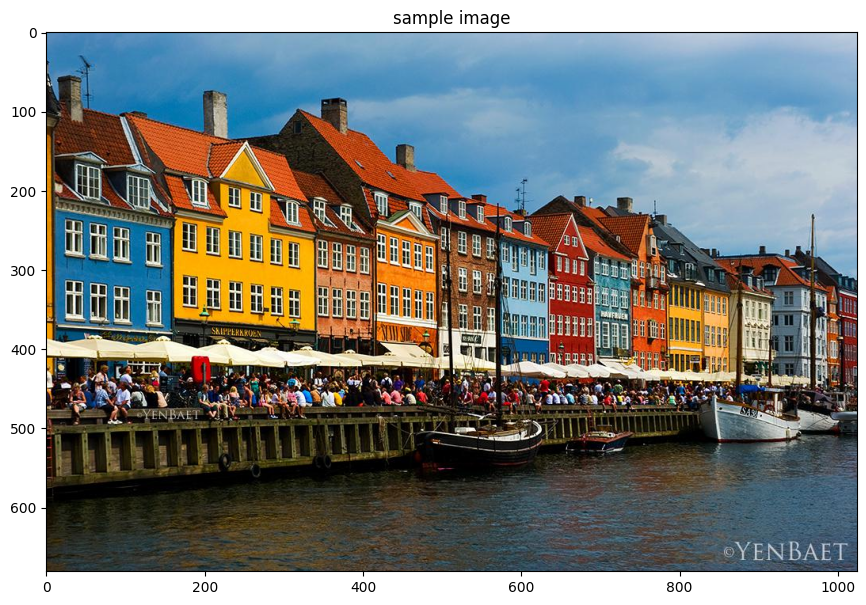

In [15]:
day_dir = '/content/drive/MyDrive/unpaired day night/day'
night_dir = '/content/drive/MyDrive/unpaired day night/night'


#plotting a sample image
plt.figure(figsize=(14,7))

img = plt.imread(day_dir + '/' + os.listdir(day_dir)[0])
plt.imshow(img)
plt.title('sample image')
print('Image dimensions {}'.format(img.shape))
plt.show()

# **Data Pre-Processing**

In [16]:
def load_image(image_file):
    #load a image file
    image = tf.io.read_file(image_file)
    image = tf.io.decode_jpeg(image)

    return image


def random_crop(image):
    #randomly crop image into defined size
    cropped_image = tf.image.random_crop(image, size=[configuration_vars.IMG_HEIGHT, configuration_vars.IMG_WIDTH, 3])

    return cropped_image


def normalize(image):
    #normalizing the images to [-1, 1]
    image = tf.cast(image, tf.float32)
    image = (image / 127.5) - 1
    return image


def de_normalize(image):
    #De normalize the image to be in range (0,1)
    return (image * 0.5) + 0.5


In [17]:
def image_augmentations(image):
    # performing rotations
    rotate = tf.random.uniform([], 0, 1.0, dtype=tf.float32)

    if rotate > .8:
        image = tf.image.rot90(image, k=3) # rotate 270
    elif rotate > .6:
        image = tf.image.rot90(image, k=2) # rotate 180
    elif rotate > .4:
        image = tf.image.rot90(image, k=1)  # rotate 90

    # Flipping Images randomly
    flip = tf.random.uniform([], 0, 1.0, dtype=tf.float32)

    if flip > 0.7:
        image = tf.image.random_flip_left_right(image)
    elif flip < 0.3:
        image = tf.image.random_flip_up_down(image)

    return image

In [18]:
def random_jitter(image):
#resize and randommly crop the input image
  # resizing image
  image = tf.image.resize(image, size=(configuration_vars.resize_height, configuration_vars.resize_width),
                        method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  # randomly cropping to 512,512
  image = random_crop(image)

  return image

def preprocess_image_train(image):
    image = load_image(image)
    image = random_jitter(image)
    image= image_augmentations(image)
    image = normalize(image)
    return image


#same function, without the augemntation
def preprocess_image_eval(image):
    image = load_image(image)
    image = random_jitter(image)
    image = normalize(image)
    return image



# Creating Dataset

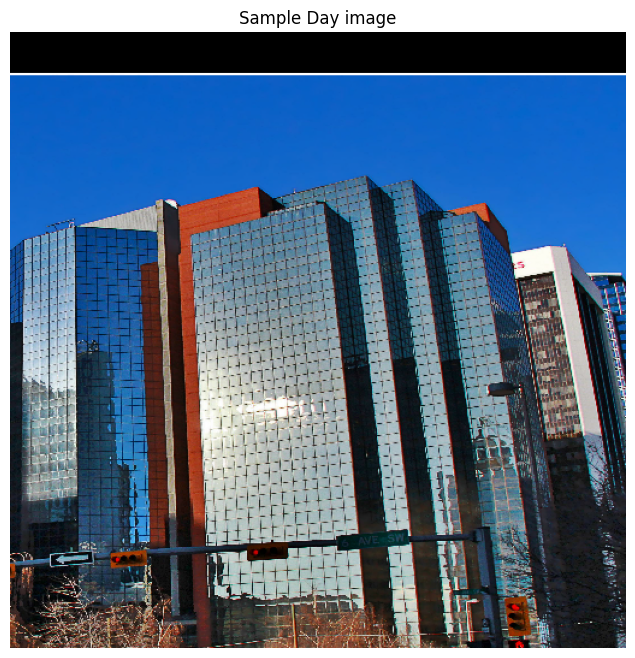

In [19]:
def create_img_dataset(directory,
                       image_preprocess_fn,
                       image_extension = 'jpg',
                       repeat=True
                      ):
    #create a tf dataset object from a directory of images
    img_list = glob(directory+f'/*{image_extension}')

    dataset = tf.data.Dataset.list_files(img_list)

    dataset = dataset.map(image_preprocess_fn,
                          num_parallel_calls=tf.data.AUTOTUNE)

    if repeat :
        dataset = dataset.repeat()

    dataset = dataset.shuffle(configuration_vars.BUFFER_SIZE).batch(configuration_vars.BATCH_SIZE)

    return dataset


Day_data = create_img_dataset(directory = day_dir,image_preprocess_fn = preprocess_image_train)

#without augmentation
Day_val = create_img_dataset(directory = day_dir,
                            image_preprocess_fn = preprocess_image_eval)



fig,ax = plt.subplots(figsize=(16,8))

inp_img = next(iter(Day_data))
plt.imshow(de_normalize(inp_img[0]))
plt.title('Sample Day image')
plt.axis('off')

plt.show()

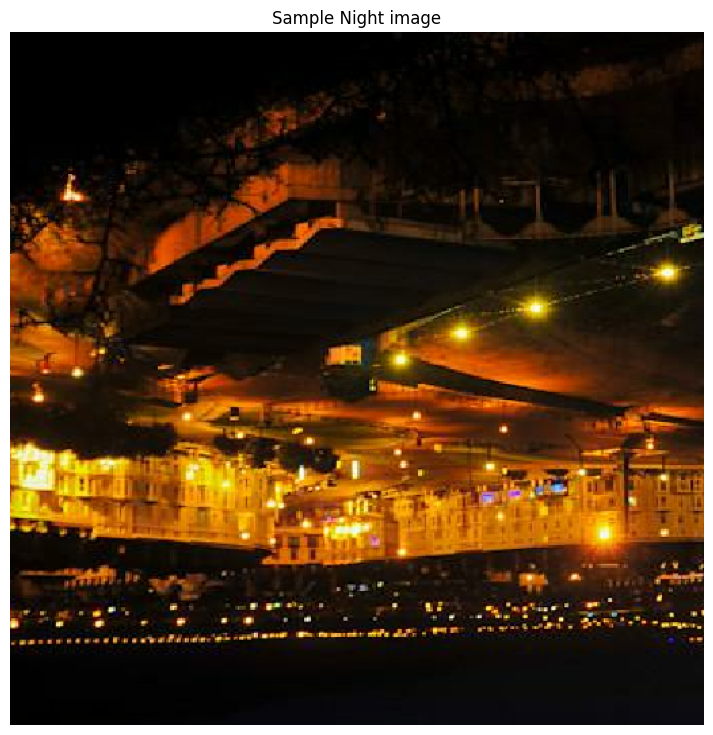

In [20]:
Night_data = create_img_dataset(directory = night_dir,image_preprocess_fn = preprocess_image_train)
Night_val = create_img_dataset(directory = night_dir,
                                image_preprocess_fn = preprocess_image_eval)

fig,ax = plt.subplots(figsize=(18,9))


inp_img = next(iter(Night_data))
plt.imshow(de_normalize(inp_img[0]))
plt.title('Sample Night image')
plt.axis('off')

plt.show()


In [12]:
# train data set

Train_Dataset = tf.data.Dataset.zip((Day_data,Night_data))

<h2 style='color:green'> Building Model</h2>


**Upsampling and downsampling blocks**

In [13]:

#Convolution weights initilaizer
conv_initializer = tf.random_normal_initializer(mean=0.0,stddev=0.02)

#initilaizer for intance normalization
gamma_initializer = tf.keras.initializers.RandomNormal(mean=0.0,stddev=0.02)

def downsample(input_layer,filters,name,activation=tf.keras.layers.LeakyReLU(),size=3,strides=2):

    #performing downsampling using a Convolution layer followed by Instance Normalization and Activation layer
    x = tf.keras.layers.Conv2D(filters,
                                  size,
                                  strides=strides,
                                  padding='same',
                                  use_bias=True,
                                  kernel_initializer=conv_initializer,
                                  name='encoder_{}'.format(name))(input_layer)


    x = tfa.layers.InstanceNormalization(axis=-1,gamma_initializer=gamma_initializer)(x)

    x = tf.keras.layers.LeakyReLU()(x)

    return x

# function used to upscale the low-resolution features
def upsample(input_layer,filters,name,size=3,strides=2):

    x = tf.keras.layers.Conv2DTranspose(filters, size,
                                          strides=strides,
                                          padding='same',
                                          use_bias=True,
                                          kernel_initializer=conv_initializer,
                                          name='decoder_{}'.format(name))(input_layer)

    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)

    x =  tf.keras.layers.LeakyReLU()(x)

    return x

**Residual block**

In [14]:
#performs 2 convolutions and then integrates a skip connection with the initial input
def residual_block(input_layer,
                   size=3,
                   strides=1,
                   name='block_x'):

    num_filters = input_layer.shape[-1]
    x = tf.keras.layers.Conv2D(num_filters,
                     size,
                     strides=strides,
                     padding='same',
                     use_bias=True,
                     kernel_initializer=conv_initializer,
                     name='residual_{}'.format(name))(input_layer)

    x = tf.keras.layers.Activation('LeakyReLU')(x)
    x = tf.keras.layers.Conv2D(num_filters, size, strides=strides, padding='same', use_bias=True,
                     kernel_initializer=conv_initializer, name='transformer_{}_2'.format(name))(x)

    result = tf.keras.layers.Add()([x, input_layer])

    return result


def concatenate_layer(layer_1,layer_2,name):
    #concatenate the layers
    return tf.keras.layers.Concatenate(name=name)([layer_1,layer_2])


<h3 style='color:lightgreen'> Building Generator</h3>


In [15]:
#To add noise to the convolution layer
class AddNoise(layers.Layer):
    def build(self, input_shape):

      n, h, w, c = input_shape[0]
      initializer = keras.initializers.RandomNormal(mean=0.0, stddev=1.0)
      self.b = self.add_weight(
          shape=[1, 1, 1, c], initializer=initializer, trainable=True, name="kernel"
      )

    def call(self, inputs):
      x, noise = inputs
      output = x + self.b * noise
      return output

# to perform adaptive Instance Normalization
class AdaIN(layers.Layer):
    def __init__(self, gain=.14, **kwargs):
      super().__init__(**kwargs)
      self.gain = gain

    def build(self, input_shapes):
      x_shape = input_shapes[0]
      w_shape = input_shapes[1]

      self.w_channels = w_shape[-1]
      self.x_channels = x_shape[-1]

      self.dense_1 = tf.keras.layers.Dense(self.x_channels,)
      self.dense_2 = tf.keras.layers.Dense(self.x_channels,)

    def call(self, inputs):
      x, w = inputs
      ys = tf.reshape(self.dense_1(w), (-1, 1, 1, self.x_channels))
      yb = tf.reshape(self.dense_2(w), (-1, 1, 1, self.x_channels))
      return self.gain * ( (ys * x) + yb)


In [16]:
conv_initializer = tf.random_normal_initializer(mean=0.0,stddev=0.02)
# function that is used to extract style code from the dayimage
def down_mapping(input_shape=(512,512,3)):
  inp=layers.Input(shape=input_shape)
  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(inp) #(512,512,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(256,256,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(128,128,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(64,64,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(32,32,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(16,16,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(8,8,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=512,kernel_size=2,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(4,4,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=256,kernel_size=2,strides=1,padding='valid',kernel_initializer=conv_initializer)(x) #(2,2,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)
  x = tf.keras.layers.Flatten()(x)

  for i in range(6):
      x = tf.keras.layers.Dense(512)(x)
      x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
      x = layers.LeakyReLU(0.2)(x)
  x = tf.keras.layers.Dense(512)(x)

  return keras.Model(inp, x)

night2day_gen_downmap=down_mapping() #used to get stylecode of day images

In [67]:
night2day_gen_downmap.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 512, 512, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 256, 256, 256)     7168      
                                                                 
 instance_normalization (In  (None, 256, 256, 256)     512       
 stanceNormalization)                                            
                                                                 
 activation (Activation)     (None, 256, 256, 256)     0         
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 256)     590080    
                                                                 
 instance_normalization_1 (  (None, 128, 128, 256)     512       
 InstanceNormalization)                                      

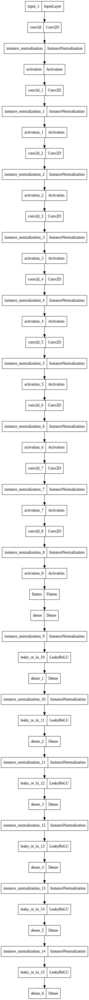

In [68]:
tf.keras.utils.plot_model(night2day_gen_downmap)

In [84]:
def n2d_generator(num_residual_connections=10):

    input_ = tf.keras.layers.Input(shape=(configuration_vars.IMG_WIDTH,configuration_vars.IMG_HEIGHT,3),
                                   name='input_layer')

    style_code=layers.Input(shape=512)

    noise = []
    noise_shapes = [(64, 64, 1), (128, 128, 1), (256, 256, 1), (512, 512, 1)]

    for shape in noise_shapes:
        noise_input = layers.Input(shape=shape)
        noise.append(noise_input)

    #-----------------------ENCODER-------------------------------
    #downsample images
    enc1 = downsample(input_layer = input_, filters=64,  strides =  1, size=7, name='dwn_1')    # (bs, 512,512, 64)

    enc2 = downsample(input_layer=enc1,filters= 128,size =  3, strides =  2, name='dwn_2')      # (bs, 256, 256, 128)

    enc3 = downsample(input_layer=enc2, filters=256,size =  3, strides =2, name='dwn_3')        # (bs, 128,128,256)

    enc4 = downsample(input_layer=enc3, filters=256,size =  3, strides =2, name='dwn_4')        # (bs, 64,64,256)

    #-----------------------Residual connections-------------------------------
    x = enc4
    for n in range(num_residual_connections):
        x = residual_block(input_layer=x, name=f'res_block_{n+1}')     # (bs, 64, 64, 256)

    #-----------------------DECODER-------------------------------

    #upsample 1
    x_skip = concatenate_layer(layer_1=x,layer_2=enc4,name='skip_1')
    dec1 = upsample(x_skip,filters=256 ,name='upsam_1')  # (bs, 128, 128, 256)

    dec1 = AdaIN()([dec1, style_code])

    dec1 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec1)
    dec1 = InstanceNormalization()(dec1)
    dec1 = layers.LeakyReLU(0.2)(dec1)

    dec1 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec1)
    dec1 = InstanceNormalization()(dec1)
    dec1 = layers.LeakyReLU(0.2)(dec1)

    dec1 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec1)
    dec1 = InstanceNormalization()(dec1)
    dec1 = layers.LeakyReLU(0.2)(dec1)

    dec1 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec1)
    dec1 = InstanceNormalization()(dec1)
    dec1 = layers.LeakyReLU(0.2)(dec1)

    dec1 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec1)
    dec1 = layers.LeakyReLU(0.2)(dec1)


    #upsample 2
    x_skip = concatenate_layer(layer_1=dec1,layer_2=enc3,name='skip_2')
    dec_2 = upsample(x_skip, filters=128,name='upsam_2') # (bs, 256, 256, 128)

    dec_2 = AdaIN()([dec_2, style_code])

    dec_2 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec_2)
    dec_2 = InstanceNormalization()(dec_2)
    dec_2 = layers.LeakyReLU(0.2)(dec_2)

    dec_2 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec_2)
    dec_2 = InstanceNormalization()(dec_2)
    dec_2 = layers.LeakyReLU(0.2)(dec_2)

    dec_2 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec_2)
    dec_2 = InstanceNormalization()(dec_2)
    dec_2 = layers.LeakyReLU(0.2)(dec_2)

    dec_2 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec_2)
    dec_2 = layers.LeakyReLU(0.2)(dec_2)

    #upsample 3
    x_skip = concatenate_layer(layer_1=dec_2,layer_2=enc2,name='skip_3')
    dec_3 = upsample(x_skip, filters= 64,name='upsam_3') # (bs, 512, 512, 64)

    dec_3 = AdaIN()([dec_3, style_code])

    dec_3 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec_3)
    dec_3 = InstanceNormalization()(dec_3)
    dec_3 = layers.LeakyReLU(0.2)(dec_3)

    dec_3 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec_3)
    dec_3 = InstanceNormalization()(dec_3)
    dec_3 = layers.LeakyReLU(0.2)(dec_3)

    dec_3 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec_3)
    dec_3 = InstanceNormalization()(dec_3)
    dec_3 = layers.LeakyReLU(0.2)(dec_3)

    dec_3 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec_3)
    dec_3 = layers.LeakyReLU(0.2)(dec_3)

    #upsample 4
    dec_4 = concatenate_layer(layer_1=dec_3,layer_2=enc1,name='skip_final')
    dec_4 = AdaIN()([dec_4, style_code])

    dec_4 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec_4)
    dec_4 = InstanceNormalization()(dec_4)
    dec_4 = layers.LeakyReLU(0.2)(dec_4)

    dec_4 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec_4)
    dec_4 = InstanceNormalization()(dec_4)
    dec_4 = layers.LeakyReLU(0.2)(dec_4)

    dec_4 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec_4)
    dec_4 = layers.LeakyReLU(0.2)(dec_4)

    dec_4 = tf.keras.layers.Conv2D(filters=64, kernel_size=3,strides=1,padding='same')(dec_4)
    dec_4 = layers.LeakyReLU(0.2)(dec_4)


    output = tf.keras.layers.Conv2D(filters = 3,kernel_size = 7, strides=1, padding='same',
                                  kernel_initializer=conv_initializer, use_bias=True, activation='tanh',
                                  name='output_layer')(dec_4)


    return tf.keras.models.Model(inputs=[input_,style_code]+noise ,outputs=output)


#plot model
# night images to day images
night2day_gen = n2d_generator()

night2day_gen.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer RandomNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


Model: "model_14"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_layer (InputLayer)    [(None, 512, 512, 3)]        0         []                            
                                                                                                  
 encoder_dwn_1 (Conv2D)      (None, 512, 512, 64)         9472      ['input_layer[0][0]']         
                                                                                                  
 instance_normalization_146  (None, 512, 512, 64)         128       ['encoder_dwn_1[0][0]']       
  (InstanceNormalization)                                                                         
                                                                                                  
 leaky_re_lu_274 (LeakyReLU  (None, 512, 512, 64)         0         ['instance_normalizatio

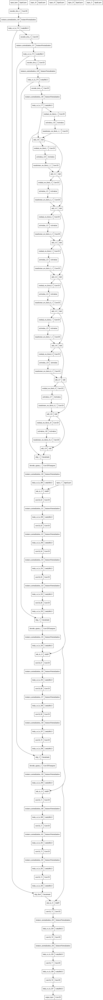

In [85]:
#plot the model
tf.keras.utils.plot_model(night2day_gen,dpi=80,show_shapes=False)

In [82]:
def d2n_generator(num_residual_connections=10):

    input_ = tf.keras.layers.Input(shape=(configuration_vars.IMG_WIDTH,configuration_vars.IMG_HEIGHT,3),
                                   name='input_layer')


    #-----------------------ENCODER-------------------------------
    #downsample images
    ds_1 = downsample(input_layer = input_, filters=64,  strides =  1, size=7, name='dwn_1')    # (bs, 512,512, 64)
    ds_2 = downsample(input_layer=ds_1,filters= 128,size =  3, strides =  2, name='dwn_2')      # (bs, 256, 256, 128)
    ds_3 = downsample(input_layer=ds_2, filters=256,size =  3, strides =2, name='dwn_3')        # (bs, 128,128,256)
    ds_4 = downsample(input_layer=ds_3, filters=256,size =  3, strides =2, name='dwn_4')        # (bs, 64,64,256)

    #-----------------------Residual connections-------------------------------
    x = ds_4
    for n in range(num_residual_connections):
        x = residual_block(input_layer=x, name='res_block_{}'.format(n+1))     # (bs, 64, 64, 256)

    #-----------------------DECODER-------------------------------
    #UNET like skip connection
    #upsample 1
    x_skip = concatenate_layer(layer_1=x,layer_2=ds_4,name='skip_1')
    up_1 = upsample(x_skip,filters=256 ,name='upsam_1')  # (bs, 128, 128, 256)

    #upsample 2
    x_skip = concatenate_layer(layer_1=up_1,layer_2=ds_3,name='skip_2')
    up_2 = upsample(x_skip, filters=128,name='upsam_2') # (bs, 256, 256, 128)

    #upsample 3
    x_skip = concatenate_layer(layer_1=up_2,layer_2=ds_2,name='skip_3')
    up_3 = upsample(x_skip, filters= 64,name='upsam_3') # (bs, 512, 512, 64)

    x_skip = concatenate_layer(layer_1=up_3,layer_2=ds_1,name='skip_final')

    output = tf.keras.layers.Conv2D(filters = 3,kernel_size = 7, strides=1, padding='same',kernel_initializer=conv_initializer, use_bias=True, activation='tanh',
                                  name='output_layer')(x_skip)


    return tf.keras.models.Model(inputs=input_,outputs=output)


# day images to night images
day2night_gen = d2n_generator()

day2night_gen.summary()

Model: "model_13"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_layer (InputLayer)    [(None, 512, 512, 3)]        0         []                            
                                                                                                  
 encoder_dwn_1 (Conv2D)      (None, 512, 512, 64)         9472      ['input_layer[0][0]']         
                                                                                                  
 instance_normalization_139  (None, 512, 512, 64)         128       ['encoder_dwn_1[0][0]']       
  (InstanceNormalization)                                                                         
                                                                                                  
 leaky_re_lu_257 (LeakyReLU  (None, 512, 512, 64)         0         ['instance_normalizatio

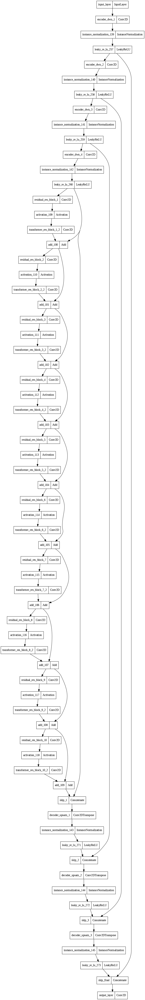

In [83]:
#plot model
tf.keras.utils.plot_model(day2night_gen,dpi=80,show_shapes=False)

In [21]:
#random noise
def gen_noise():
  noise=[]
  for i in range(6,10):
    noise.append(tf.random.normal((1,2**i,2**i,1)))
  return noise
noise = gen_noise()


<h3 style='color:green'> Building Discriminator</h3>


In [22]:
def PATCH_discriminator(leak_rate = 0.2):
    '''PATCH discriminator network'''
    leaky_relu = tf.keras.layers.LeakyReLU(leak_rate)


    input_ = tf.keras.layers.Input(shape=(configuration_vars.IMG_WIDTH,configuration_vars.IMG_HEIGHT,3),
                               name='input_layer')
    # Encoder
    # Input image 512,512
    x = downsample(input_layer = input_, filters=64,  strides =  2, name='dw_1', size=4, activation = leaky_relu)    #h,w =256
    x = tf.keras.layers.Dropout(0.2)(x)

    x = downsample(input_layer = x, filters=128,  strides =  2, name='dw_2', size=4, activation = leaky_relu)        #h,w =128
    x = tf.keras.layers.Dropout(0.2)(x)

    x = downsample(input_layer = x, filters=256,  strides =  2, name='dw_3',size=4,activation = leaky_relu)        #h,w = 64
    x = tf.keras.layers.Dropout(0.2)(x)

    x = downsample(input_layer = x, filters=256,  strides =  2, name='dw_4',size=4,activation = leaky_relu)        #h,w = 32
    x = tf.keras.layers.Dropout(0.2)(x)

    x = downsample(input_layer = x, filters=256,  strides =  1, name='dw_5',size=4,activation = leaky_relu)        #h,w = 32

    output1 = tf.keras.layers.Conv2D(1, 4, strides=1, padding='valid', kernel_initializer=conv_initializer)(x)         #(29, 29, 1)

    x = downsample(input_layer = x, filters=256,  strides =  2, name='dw_6', size=4,activation = leaky_relu)        #h,w = 16
    x = tf.keras.layers.Dropout(0.2)(x)

    x = downsample(input_layer = x, filters=256,  strides =  2, name='dw_7',size=4,activation = leaky_relu)        #h,w = 8
    x = tf.keras.layers.Dropout(0.2)(x)

    x = downsample(input_layer = x, filters=256,  strides =  2, name='dw_8',size=4,activation = leaky_relu)        #h,w = 4
    x = tf.keras.layers.Dropout(0.2)(x)

    x = downsample(input_layer = x, filters=256,  strides =  2, name='dw_9',size=2,activation = leaky_relu)        #h,w = 2
    x = tf.keras.layers.Flatten()(x)

    x = tf.keras.layers.Dense(units=512)(x)

    return tf.keras.models.Model(inputs=input_,outputs=[output1,x])



#create instance of discriminators
day2night_disc = PATCH_discriminator()  # identify night images
night2day_disc = PATCH_discriminator()  # identify day images


In [78]:
day2night_disc.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_layer (InputLayer)    [(None, 512, 512, 3)]        0         []                            
                                                                                                  
 encoder_dw_1 (Conv2D)       (None, 256, 256, 64)         3136      ['input_layer[0][0]']         
                                                                                                  
 instance_normalization_41   (None, 256, 256, 64)         128       ['encoder_dw_1[0][0]']        
 (InstanceNormalization)                                                                          
                                                                                                  
 leaky_re_lu_68 (LeakyReLU)  (None, 256, 256, 64)         0         ['instance_normalization

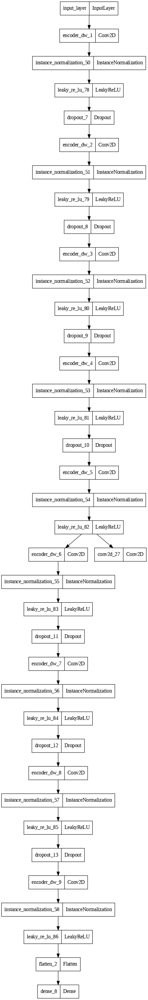

In [77]:
#plot model
tf.keras.utils.plot_model(night2day_disc,dpi=80,show_shapes=False)

In [24]:
def generate_cycle(gen_1,gen_2,input_image,n2d=False,noise=None,style_code=None):
    # used to generate a full cycle of images using given generators
    if n2d:
      gen_img_1 = gen_1([input_image,style_code]+ noise,training=True)
      gen_img_2 = gen_2(gen_img_1,training=True)
      return gen_img_1,gen_img_2
    else:
      gen_img_1 = gen_1(input_image,training=True)
      gen_img_2 = gen_2([gen_img_1,style_code]+ noise,training=True)
      return gen_img_1,gen_img_2



def calculate_and_apply_gradients(tape, model,loss,optimizer):

  if len(model) ==2:
    trainable_weights=(model[0].trainable_weights + model[1].trainable_weights)
  else:
    trainable_weights=model[0].trainable_weights
  #calculate gradients of loss function
  gradients = tape.gradient(loss,trainable_weights)

  #apply gradients
  optimizer.apply_gradients(zip(gradients,trainable_weights))
  return

<h3 style='color:green' >losses </h3>

In [25]:
# WLoss for Discriminator Patch
def discriminator_PatchWloss(real_img_patches, fake_img_patches):
  real_loss = tf.reduce_mean(real_img_patches, axis=[1, 2, 3])
  fake_loss = tf.reduce_mean(fake_img_patches, axis=[1, 2, 3])
  return tf.reduce_mean(fake_loss - real_loss)

# WLoss for generator Patch
def generator_PatchWloss(fake_img_patches):
    return -tf.reduce_mean(fake_img_patches, axis=[1, 2, 3])

# Cycle consistency los
def calculate_cycle_loss(real_image, cycled_image, LAMBDA):
    '''pixel wise cycle loss between original image and cycled image'''
    mae_loss = tf.reduce_mean(tf.abs(real_image - cycled_image))

    return LAMBDA * mae_loss

# Wasserstein Loss
def discriminator_Wloss(real_img, fake_img):
    real_loss = tf.reduce_mean(real_img)
    fake_loss = tf.reduce_mean(fake_img)
    return fake_loss - real_loss


# the Wloss function for the generator.
def generator_Wloss(fake_img):
    return -tf.reduce_mean(fake_img)

# identity loss
def identity_loss(real_image, same_image, LAMBDA):
    mae_loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return LAMBDA * 0.5 * mae_loss

In [26]:
#retrieving the saved model
print(glob(os.path.join('/content/drive/MyDrive/WI2I I model save point', "*.h5")))
a=glob(os.path.join('/content/drive/MyDrive/WI2I I model save point', "*.h5"))[0]
a.split('_')[-1].split('.')[0]

['/content/drive/MyDrive/WI2I I model save point/gen_d2n_weights_epoch_144.h5', '/content/drive/MyDrive/WI2I I model save point/gen_n2d_weights_epoch_144.h5', '/content/drive/MyDrive/WI2I I model save point/disc_d2n_weights_epoch_144.h5', '/content/drive/MyDrive/WI2I I model save point/disc_n2d_weights_epoch_144.h5', '/content/drive/MyDrive/WI2I I model save point/night2day_gen_downmap_weights_epoch_144.h5']


'144'

In [27]:
# loading model weights
day2night_gen.load_weights('/content/drive/MyDrive/WI2I I model save point/gen_d2n_weights_epoch_{}.h5'.format(a.split('_')[-1].split('.')[0]))
night2day_gen.load_weights('/content/drive/MyDrive/WI2I I model save point/gen_n2d_weights_epoch_{}.h5'.format(a.split('_')[-1].split('.')[0]))
day2night_disc.load_weights('/content/drive/MyDrive/WI2I I model save point/disc_d2n_weights_epoch_{}.h5'.format(a.split('_')[-1].split('.')[0]))
night2day_disc.load_weights('/content/drive/MyDrive/WI2I I model save point/disc_n2d_weights_epoch_{}.h5'.format(a.split('_')[-1].split('.')[0]))
night2day_gen_downmap.load_weights('/content/drive/MyDrive/WI2I I model save point/night2day_gen_downmap_weights_epoch_{}.h5'.format(a.split('_')[-1].split('.')[0]))

In [28]:
class CycleGAN(tf.keras.models.Model):
    def __init__(self,
                 lambda_cycle=40):
        super(CycleGAN, self).__init__()
        self.gen_d2n = day2night_gen # Day > Night
        self.gen_n2d_downsample=night2day_gen_downmap
        self.gen_n2d = night2day_gen # Night > Day
        self.disc_d2n = day2night_disc # Classifies Night Images
        self.disc_n2d = night2day_disc # Classifier Day Images
        self.lambda_cycle = lambda_cycle #lambda in cycle consistancy loss
        self.gp_weight = 30 # penalty set from 10 to 8 to 10

    def compile(self,
                gen_loss_fn,
                disc_loss_fn,
                cycle_loss_fn,
                identity_loss_fn,
                disc_Wloss,
                gen_Wloss,
                common_opt):

        super(CycleGAN, self).compile()


        # -------optimizers ---------
        self.opt_gen_d2n = common_opt
        self.opt_gen_n2d = common_opt
        self.opt_disc_d2n = common_opt
        self.opt_disc_n2d = common_opt

        # -------losses ---------
        self.gen_loss_fn = gen_loss_fn
        self.disc_loss_fn = disc_loss_fn
        self.cycle_loss_fn = cycle_loss_fn
        self.identity_loss_fn = identity_loss_fn
        self.disc_Wloss=disc_Wloss
        self.gen_Wloss=gen_Wloss



    def gradient_penalty(self, batch_size, disc, real_images, fake_images):
      """Calculates the gradient penalty.

      This loss is calculated on an interpolated image
      and added to the discriminator loss.
      """
      # Get the interpolated image
      alpha = tf.random.normal([batch_size, 1, 1, 1], 0.0, 1.0)
      diff = fake_images - real_images
      interpolated = real_images + alpha * diff

      with tf.GradientTape() as gp_tape:
          gp_tape.watch(interpolated)
          # Getting the discriminator output for this interpolated image.
          pred = disc(interpolated, training=True)

      # 2. Calculating the gradients w.r.t to this interpolated image.
      grads = gp_tape.gradient(pred, [interpolated])[0]
      # 3. Calculating the norm of the gradients.
      norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2, 3]))
      gp = tf.reduce_mean((norm - 1.0) ** 2)
      return gp

    def gen_noise(self):
      noise=[]
      for i in range(6,10):
        noise.append(tf.random.normal((1,2**i,2**i,1)))
      return noise

    def train_step(self, batch_data):
        day_image, night_image = batch_data
        noise = self.gen_noise()

        with tf.GradientTape(persistent=True) as tape:
            # day_img_stylecode=self.gen_d2n_downsample(day_image)
            stylecode=self.gen_n2d_downsample(day_image)

            #  day > night > day (fake night for wasserstein loss)
            fake_night,cycled_day = generate_cycle(self.gen_d2n,
                                                     self.gen_n2d,noise=noise,
                                                     input_image=day_image,style_code=stylecode,n2d=False)


            #  night > day > night (fake day for wasserstein loss)
            fake_day,cycled_night = generate_cycle(self.gen_n2d,
                                                   self.gen_d2n,noise=noise,
                                                   input_image=night_image,style_code=stylecode,n2d=True)

            # generating itself (for identity loss)
            ''' if we provide a night image to the generator that is supposed to convert night images to day images
             it should recognize that the image is already a night image and not change it much'''
            iden_day = self.gen_d2n(night_image, training=True)
            iden_night = self.gen_n2d([day_image,stylecode]+noise, training=True)

            # discriminator on real images
            disc_night = self.disc_d2n(night_image, training=True)
            disc_day = self.disc_n2d(day_image, training=True)

            # discriminator on fake images
            disc_fake_night   = self.disc_d2n(fake_night, training=True)
            disc_fake_day = self.disc_n2d(fake_day, training=True)

#----------------------------------------------------------------------------LOSSES----------------------------------------------------------------------------------------

            # -------------------------generator loss-------------
            # WfakePatch  LOSS
            night_gen_loss = self.gen_loss_fn(disc_fake_night[0])
            day_gen_loss = self.gen_loss_fn(disc_fake_day[0])


            #Cycle loss loss
            total_cycle_loss = self.cycle_loss_fn(night_image, cycled_night, self.lambda_cycle) + self.cycle_loss_fn(day_image, cycled_day, self.lambda_cycle)

            #Total Gen loss (day gen and night gen)
            total_gen_d2n_loss =   total_cycle_loss + self.identity_loss_fn(night_image, iden_night,self.lambda_cycle) + self.gen_Wloss(disc_fake_night[1])+ night_gen_loss
            total_gen_n2d_loss =  total_cycle_loss + self.identity_loss_fn(day_image, iden_day, self.lambda_cycle) + self.gen_Wloss(disc_fake_day[1]) + day_gen_loss

            #----------------------------------------------------------Discriminator Loss----------------------------------------------------------------------------------
            # Discriminator WPatch LOSS
            night_disc_loss = self.disc_loss_fn(disc_night[0], disc_fake_night[0])  # check classifying generated and real night
            day_disc_loss = self.disc_loss_fn(disc_day[0], disc_fake_day[0])        # check  classifying generated and real day

            # Disc Wasserstein loss
            night_disc_Wloss = self.disc_Wloss(real_img=disc_night[1], fake_img=disc_fake_night[1]) #all are 1s
            day_disc_Wloss =  self.disc_Wloss(real_img=disc_day[1], fake_img=disc_fake_day[1])

            #gradient Penalty
            disc_night_gp = self.gradient_penalty(1, self.disc_d2n, night_image, fake_night) * self.gp_weight
            disc_day_gp = self.gradient_penalty(1,self.disc_n2d ,day_image, fake_day) * self.gp_weight

            #total disc loss night_disc_loss + ,day_disc_loss +
            total_night_disc_loss = night_disc_Wloss + disc_night_gp + night_disc_loss
            total_day_disc_loss =  day_disc_Wloss + disc_day_gp + day_disc_loss

        # Calculating and Updating gradients

        # day > night generator gradeints
        _ = calculate_and_apply_gradients(tape=tape,
                                     model= [self.gen_d2n],
                                     loss = total_gen_d2n_loss,
                                     optimizer = self.opt_gen_d2n)

        # night > day  generator gradeints
        _ = calculate_and_apply_gradients(tape=tape,
                                     model= [self.gen_n2d,self.gen_n2d_downsample],
                                     loss = total_gen_n2d_loss,
                                     optimizer = self.opt_gen_n2d)

        #  discriminator gradients (classifies night images)
        _ = calculate_and_apply_gradients(tape=tape,
                                     model= [self.disc_d2n],
                                     loss = total_night_disc_loss,
                                     optimizer = self.opt_disc_d2n)

        # Day discriminator gradients (classifies day images)
        _ = calculate_and_apply_gradients(tape=tape,
                                     model= [self.disc_n2d],
                                     loss = total_day_disc_loss,
                                     optimizer = self.opt_disc_n2d)



        return {'gen_D2N_loss': total_gen_d2n_loss,
                'gen_N2D_loss': total_gen_n2d_loss,
                'disc_day_loss': total_day_disc_loss,
                'disc_night_loss': total_night_disc_loss,
               }

In [29]:
#creat a instance of Cycle gan
model = CycleGAN()

model.compile(
            cycle_loss_fn=calculate_cycle_loss,
            identity_loss_fn=identity_loss,
            disc_Wloss=discriminator_Wloss,
            gen_Wloss=generator_Wloss,
            gen_loss_fn = generator_PatchWloss,
            disc_loss_fn=discriminator_PatchWloss,
            common_opt = tf.keras.optimizers.legacy.Adam(learning_rate=0.0003)
)

<h3 style='color:green'>Callbacks</h3>


In [32]:
def gen_noise():
  noise=[]
  for i in range(6,10):
    noise.append(tf.random.normal((1,2**i,2**i,1)))
  return noise

imgnum=0
# Callback
class GANMonitor(tf.keras.callbacks.Callback):
    """A callback to generate and save images after each epoch"""

    def __init__(self,
                 num_img=1,
                 day_paths='/content/drive/MyDrive/WI2I I image save point/day',
                 night_paths='/content/drive/MyDrive/WI2I I image save point/night'):

        self.num_img = num_img
        self.day_paths = day_paths
        self.night_paths = night_paths
        self.model_save_path = '/content/drive/MyDrive/WI2I I model save point'

        # dir to save genereated day images
        if not os.path.exists(self.day_paths):
            os.makedirs(self.day_paths)


        # dir to save genereated night images
        if not os.path.exists(self.night_paths):
            os.makedirs(self.night_paths)


    def on_epoch_end(self, epoch, logs=None):
      if (epoch+1)%1==0:
        noise=gen_noise()
        # if (epoch+1)%3==0:
        #deleteing previously saved models
        files = glob(os.path.join(self.model_save_path, "*.h5"))
        for f in files:
            os.remove(f)
        #save generator models
        self.model.gen_d2n.save_weights(os.path.join(self.model_save_path,
                                      'gen_d2n_weights_epoch_{}.h5'.format(epoch+1)))
        self.model.gen_n2d.save_weights(os.path.join(self.model_save_path,
                                      'gen_n2d_weights_epoch_{}.h5'.format(epoch+1)))

        # Save the discriminator models
        self.model.disc_d2n.save_weights(os.path.join(self.model_save_path,
                                      'disc_d2n_weights_epoch_{}.h5'.format(epoch+1)))
        self.model.disc_n2d.save_weights(os.path.join(self.model_save_path,
                                      'disc_n2d_weights_epoch_{}.h5'.format(epoch+1)))

        self.model.gen_n2d_downsample.save_weights(os.path.join(self.model_save_path,
                                      'night2day_gen_downmap_weights_epoch_{}.h5'.format(epoch+1)))

        #generated night
        for i, img in enumerate(zip(Day_val.take(self.num_img),Night_val.take(self.num_img))):
          prediction = day2night_gen(img[0], training=False)[0].numpy()
          prediction = ((prediction * 127.5 )+ 127.5).astype(np.uint8)
          prediction = PIL.Image.fromarray(prediction)
          prediction.save(f'{self.night_paths}/generated_{i}_{imgnum+(epoch+1)}.png')

        # generated day images
        for i, img in enumerate(zip(Night_val.take(self.num_img),Day_val.take(self.num_img))):
          style_code = night2day_gen_downmap(img[1])
          prediction = night2day_gen([img[0],style_code]+noise, training=False)[0].numpy()
          prediction = ((prediction * 127.5) + 127.5).astype(np.uint8)
          prediction = PIL.Image.fromarray(prediction)
          prediction.save(f'{self.day_paths}/generated_{i}_{imgnum+(epoch+1)}.png')

<h2 style='color:green'>Fitting the model</h2>


In [ ]:
#new log 1 is without noise
EPOCHS = 300

csv_logger=tf.keras.callbacks.CSVLogger(
    '/content/drive/MyDrive/WI2I I log/MFinal_2.csv', separator=',', append=True
)

callbacks = [GANMonitor(),csv_logger]
steps_per_epoch = 227

history = model.fit(Train_Dataset,
                epochs = EPOCHS,
                steps_per_epoch=steps_per_epoch,
                callbacks = callbacks,
               )

<h1 style='color:green'>Results</h1>


<h2 style='color:lightgreen'>Evaluating Day -> Night Generator</h2>


1/1 [==============================] - 1s 760ms/step


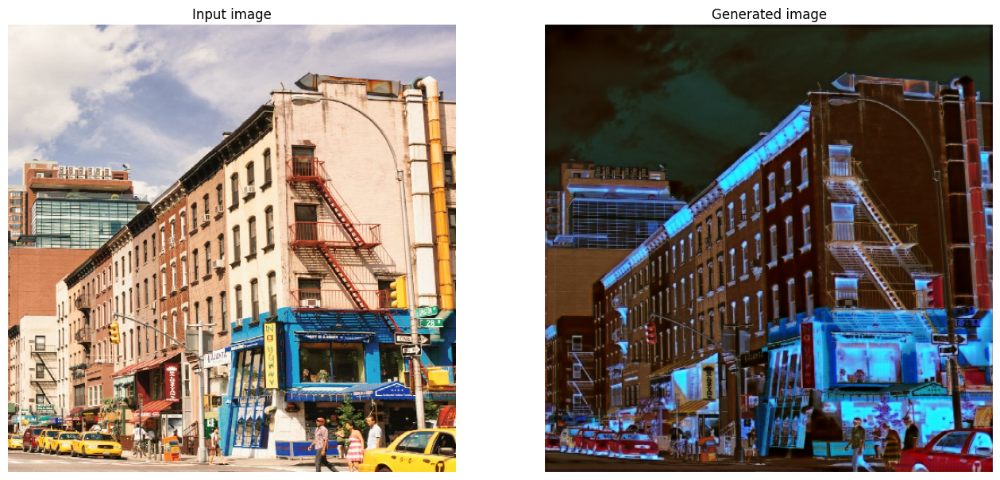

1/1 [==============================] - 0s 44ms/step


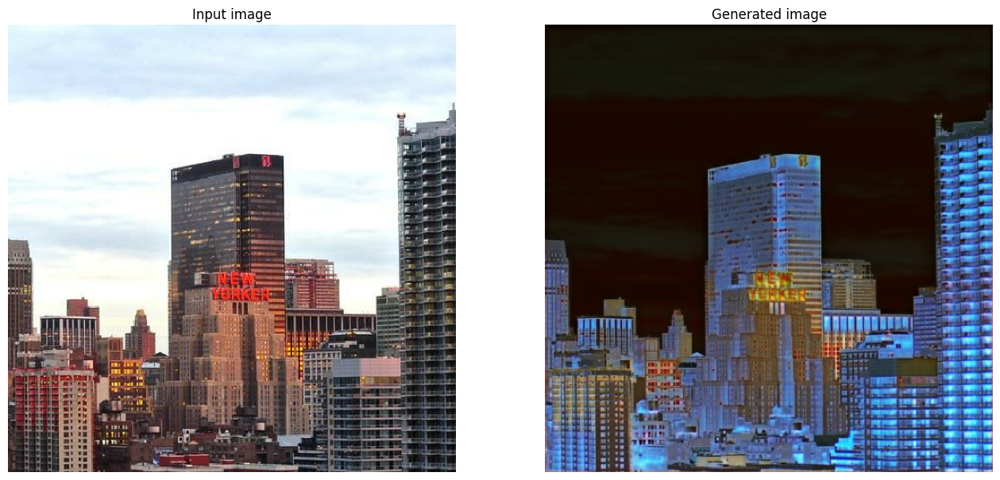

In [34]:
def display_generated_samples(ds, model, n_samples):
    ds_iter = iter(ds)
    noise=gen_noise()

    for n_sample in range(n_samples):
        example_sample = next(ds_iter)
        generated_sample = model.predict(example_sample)

        fig = plt.figure(figsize=(16,8))

        plt.subplot(121)
        plt.title('Input image')
        plt.imshow(example_sample[0] * 0.5 + 0.5)
        plt.axis('off')

        plt.subplot(122)
        plt.title('Generated image')
        plt.imshow(generated_sample[0] * 0.5 + 0.5)
        plt.axis('off')
        plt.show()


display_generated_samples(Day_val.take(2), day2night_gen, 2)

1/1 [==============================] - 0s 35ms/step


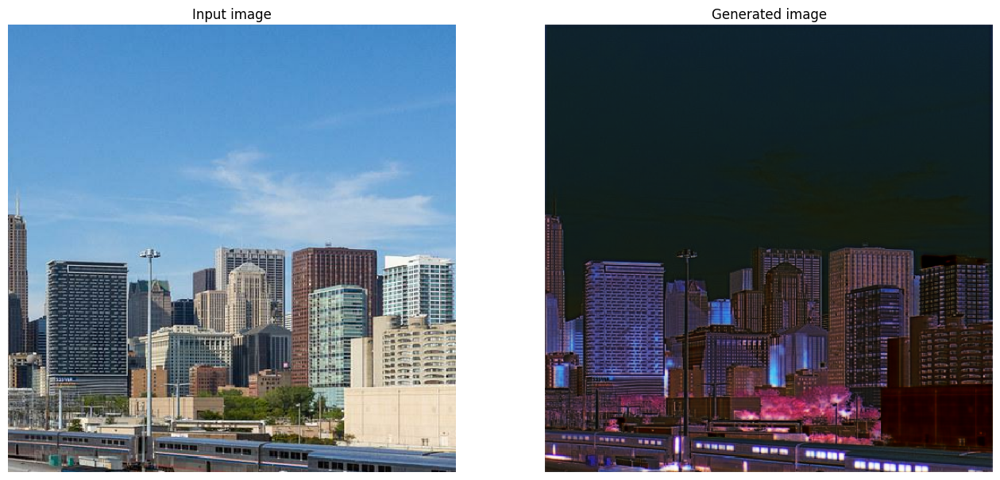

1/1 [==============================] - 0s 33ms/step


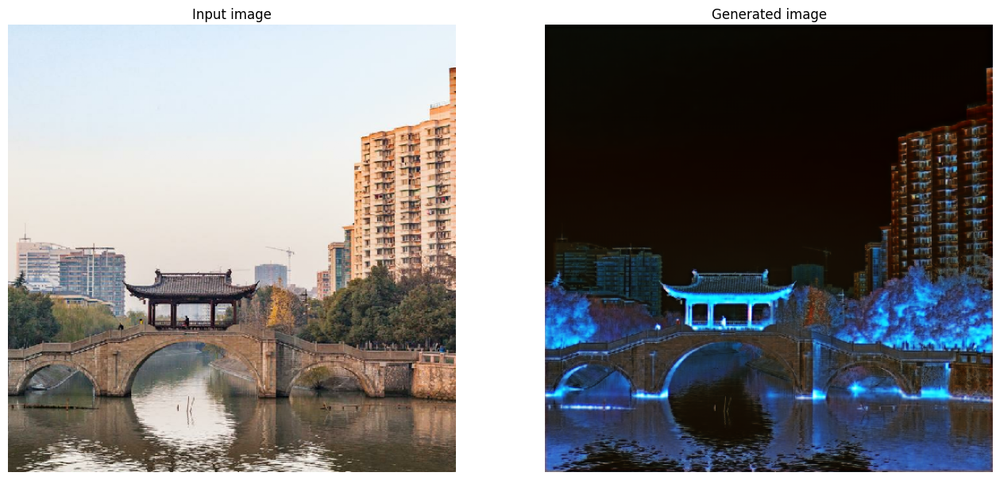

In [66]:
display_generated_samples(Day_val.take(2), day2night_gen, 2)

1/1 [==============================] - 0s 38ms/step


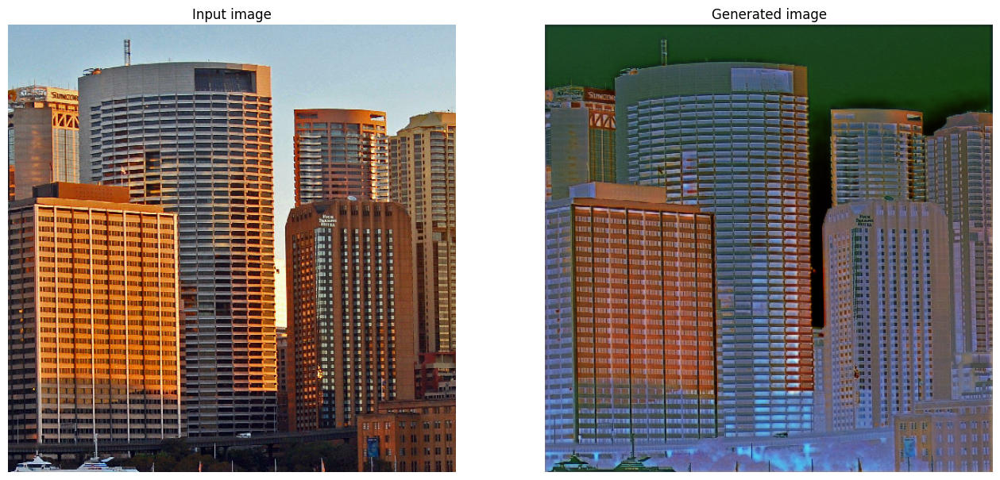

1/1 [==============================] - 0s 33ms/step


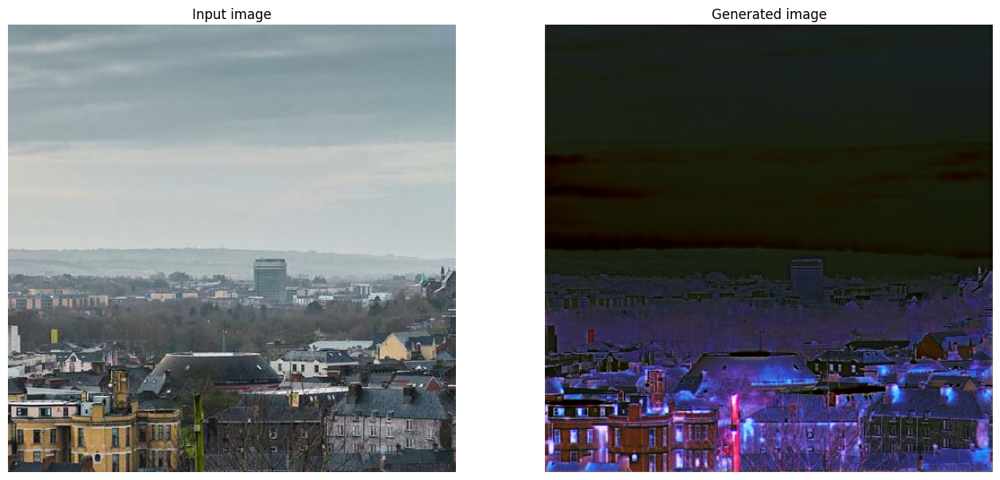

In [40]:
display_generated_samples(Day_val.take(2), day2night_gen, 2)

<h2 style='color:lightgreen'>Evaluating Night -> Day Generator</h2>


1/1 [==============================] - 0s 44ms/step


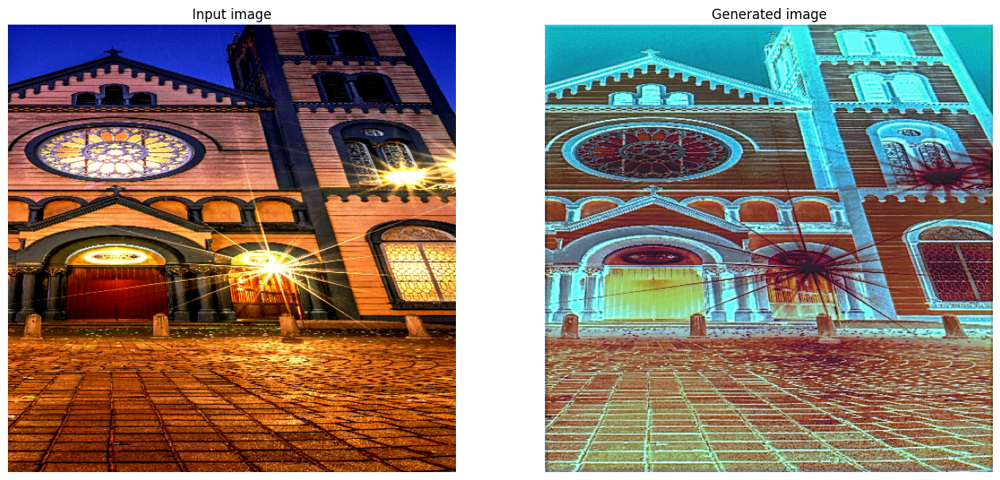

1/1 [==============================] - 0s 45ms/step


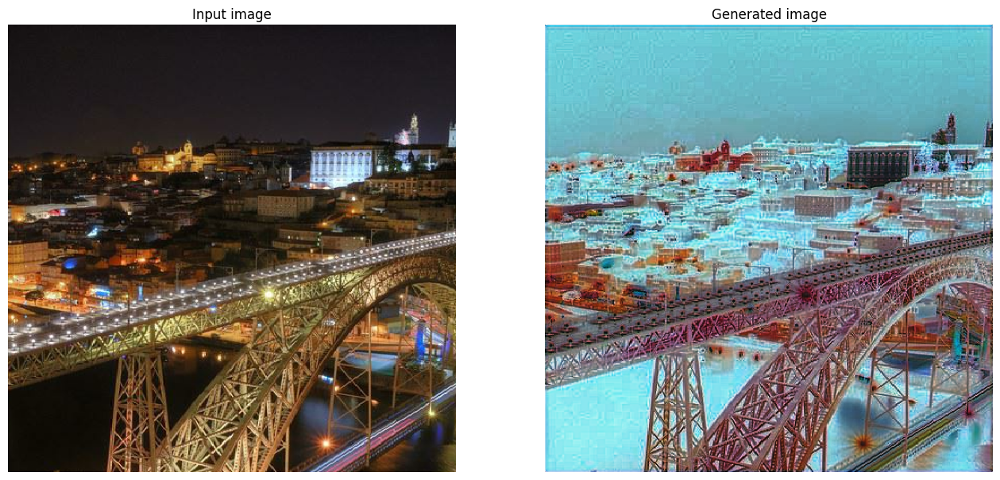

In [57]:
def gen_noise1(batch_size=1):
    noise = []
    noise_shapes = [(64, 64, 1), (128, 128, 1), (256, 256, 1), (512, 512, 1)]
    for shape in noise_shapes:
        noise_input = tf.random.normal([batch_size] + list(shape))
        noise.append(noise_input)
    return noise

def display_generated_N2D_samples(dataset, model, samples):

    ds_iter = iter(dataset)
    noise=gen_noise()
    for n_sample in range(samples):
      example_sample = next(ds_iter)
      batch_size = example_sample.shape[0]  # Get the batch size from the input sample
      style_code = night2day_gen_downmap(tf.convert_to_tensor(example_sample))
      noise = gen_noise1(batch_size=batch_size)  # Generate noise with the correct batch size
      generated_sample = model.predict([example_sample, style_code] + noise)

      fig = plt.figure(figsize=(16,8))

      plt.subplot(121)
      plt.title('Input image')
      plt.imshow(example_sample[0] * 0.5 + 0.5)
      plt.axis('off')

      plt.subplot(122)
      plt.title('Generated image')
      plt.imshow(generated_sample[0] * 0.5 + 0.5)
      plt.axis('off')
      plt.show()


display_generated_N2D_samples(Night_val.take(2), night2day_gen, 2)

1/1 [==============================] - 0s 44ms/step


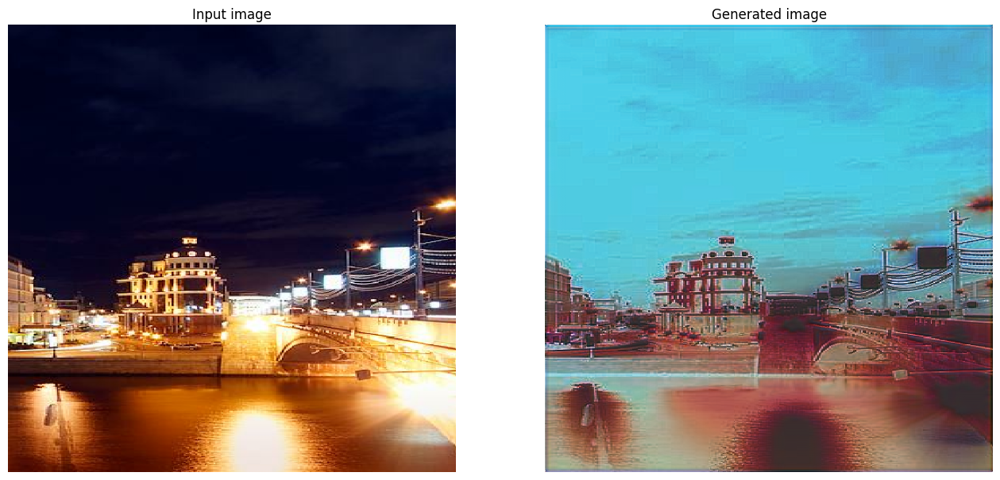

1/1 [==============================] - 0s 48ms/step


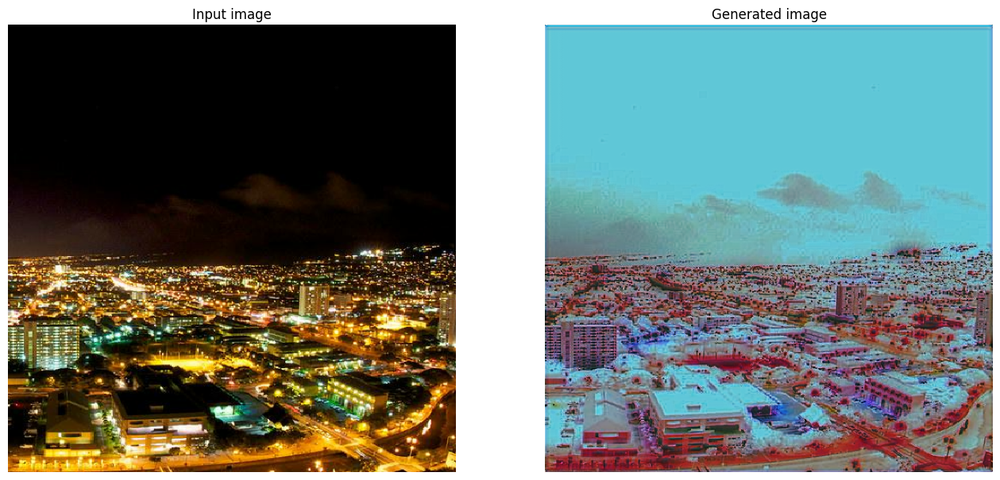

In [58]:
display_generated_N2D_samples(Night_val.take(2), night2day_gen, 2)

1/1 [==============================] - 0s 43ms/step


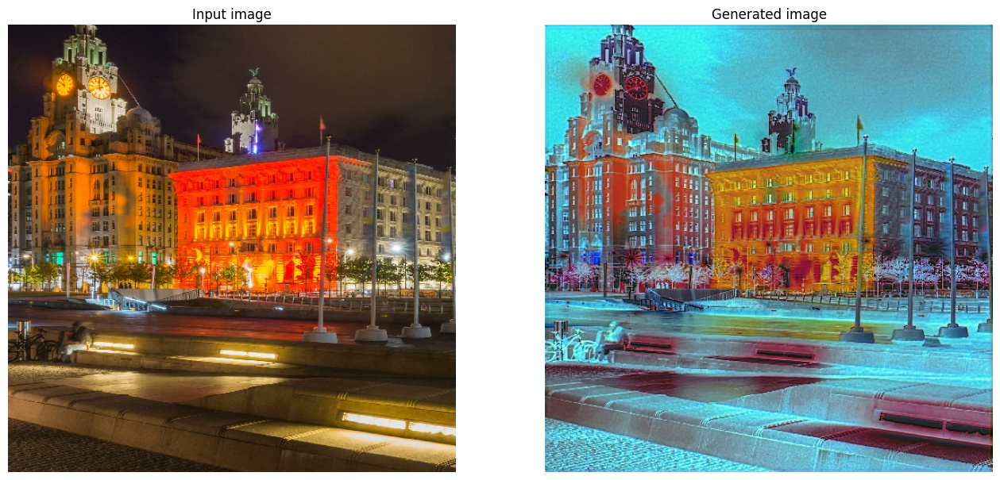

1/1 [==============================] - 0s 45ms/step


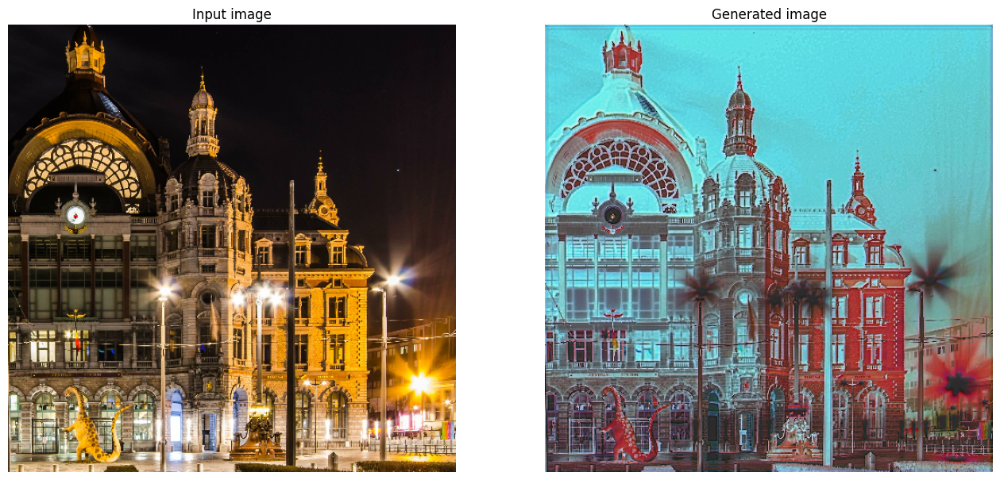

In [64]:
display_generated_N2D_samples(Night_val.take(2), night2day_gen, 2)

1/1 [==============================] - 0s 44ms/step


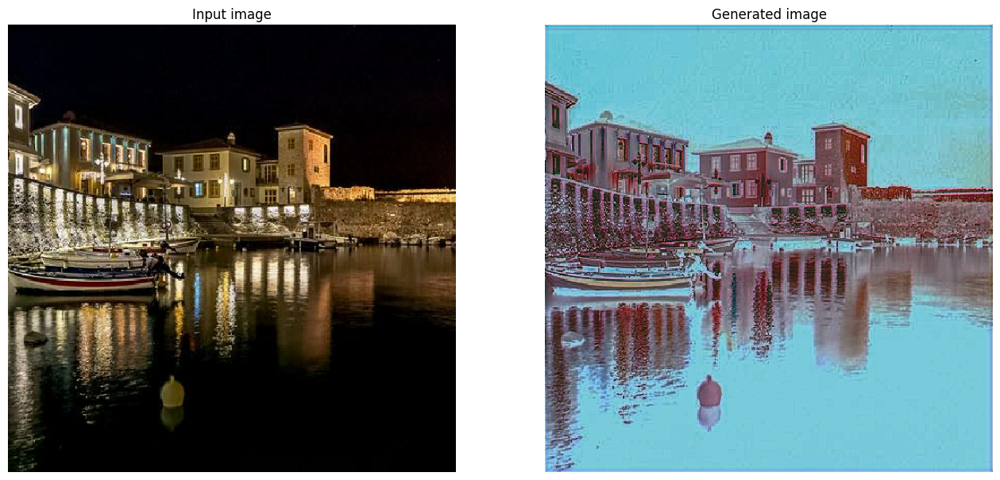

1/1 [==============================] - 0s 51ms/step


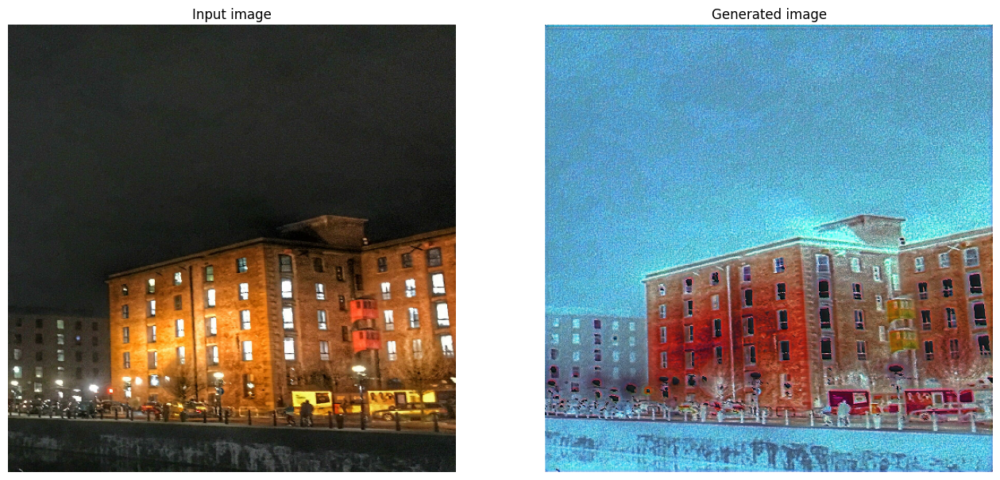

In [56]:
display_generated_N2D_samples(Night_val.take(2), night2day_gen, 2)

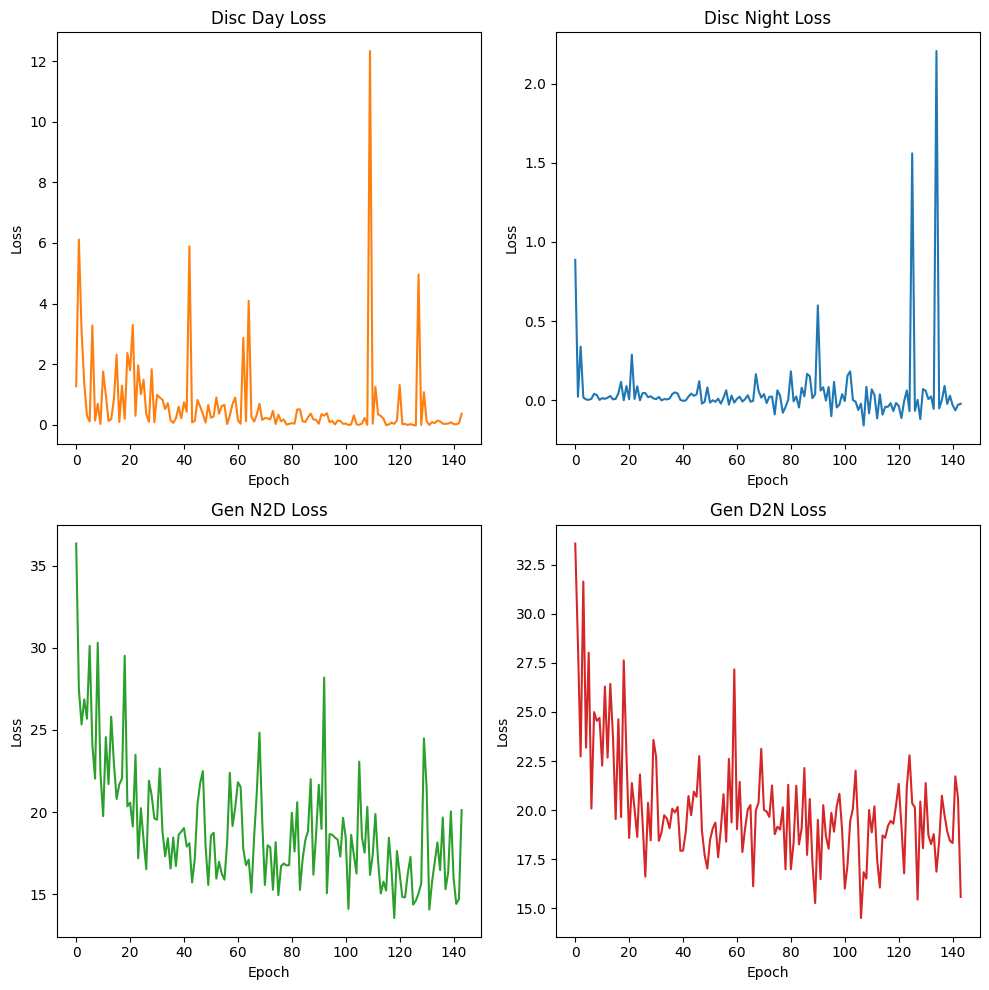

In [3]:
import pandas as pd
import matplotlib.pyplot as plt

# Read the individual CSV files
data1 = pd.read_csv('/content/drive/MyDrive/WI2I I log/MFinal_1.csv')
# data2 = pd.read_csv('/path/to/your/second/csvfile.csv')

# Merge the two dataframes
merged_data = pd.concat([data1], ignore_index=True)

# If 'epoch' column has continuous values across both CSV files, reset it to have a new continuous series
merged_data['epoch'] = range(len(merged_data))

# For columns with list values, extracting the first value in the list
# For columns with list values, extracting the first value in the list
merged_data['gen_D2N_loss'] = merged_data['gen_D2N_loss'].apply(lambda x: float(x.replace('[','').replace('"','').split(',')[0]))
merged_data['gen_N2D_loss'] = merged_data['gen_N2D_loss'].apply(lambda x: float(x.replace('[','').replace('"','').split(',')[0]))


# Create a 2x2 grid of subplots
fig, axs = plt.subplots(2, 2, figsize=(10, 10))

# Plotting each loss in a separate subplot
axs[0, 0].plot(merged_data['epoch'], merged_data['disc_day_loss'], 'tab:orange')
axs[0, 0].set_title('Disc Day Loss')

axs[0, 1].plot(merged_data['epoch'], merged_data['disc_night_loss'], 'tab:blue')
axs[0, 1].set_title('Disc Night Loss')

axs[1, 0].plot(merged_data['epoch'], merged_data['gen_N2D_loss'], 'tab:green')
axs[1, 0].set_title('Gen N2D Loss')

axs[1, 1].plot(merged_data['epoch'], merged_data['gen_D2N_loss'], 'tab:red')
axs[1, 1].set_title('Gen D2N Loss')

# Labeling x and y axes for each subplot
for ax in axs.flat:
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Loss')

# Adjust layout to prevent labels from overlapping
plt.tight_layout()
plt.show()


<h2 >References</h2>

[1. https://www.kaggle.com/code/dimitreoliveira/improving-cyclegan-monet-paintings](https://www.kaggle.com/code/dimitreoliveira/improving-cyclegan-monet-paintings)

[2. https://keras.io/examples/generative/stylegan/](https://keras.io/examples/generative/stylegan/)

[3. https://keras.io/examples/generative/wgan_gp/](https://keras.io/examples/generative/wgan_gp/)

[4. https://keras.io/examples/generative/cyclegan/](https://keras.io/examples/generative/cyclegan/)

[5. https://www.kaggle.com/code/virajkadam/day-night-image-translations-using-cyclegan](https://www.kaggle.com/code/virajkadam/day-night-image-translations-using-cyclegan)




